 <img src="img/1_presentacion.png" alt="Del GPS a un mapa en 3D">

In [1]:
from notebook.services.config import ConfigManager

cm_slide = ConfigManager()
cm_slide.update("livereveal", {
              "theme": "serif",
              "transition": "zoom",
              "scroll": True,
              "footer": "<h4>Sistemas de Radionavegación-2018</h4>",
              "width": "100%",
              "height": "100%",
})

{'width': '100%',
 'height': '100%',
 'scroll': True,
 'theme': 'serif',
 'transition': 'zoom',
 'footer': '<h4>Sistemas de Radionavegación-2018</h4>'}

## ¿Qué hicimos?

## ¿Cómo lo hicimos?

## ¿Dónde aplicarlo?

## ¿Qué concluimos?

# Trabajo práctico final

## Adquisición de datos de un terreno con Tiva y receptor GPS y su mapa de elevación con Python

* **Cátedra**: Sistemas de Radionavegación

* **Autores**: 
    * Mollinedo Rivadeneira, Bibiana.
    * Reinoso, Agustín Nahuel.

* **Año**: 2018

Bibiana Rivadeneira
Agustín Reinoso
[![](img/cc.png)](https://creativecommons.org/licenses/by-sa/4.0/deed.es)

**Atribución-CompartirIgual 4.0 Internacional (CC BY-SA 4.0)**

Este es un resumen legible por humanos (y no un sustituto) de la licencia. Advertencia.
Usted es libre de:

- Compartir — copiar y redistribuir el material en cualquier medio o formato
- Adaptar — remezclar, transformar y construir a partir del material para cualquier propósito, incluso comercialmente.

Esta licencia es aceptable para Obras Culturales Libres.

La licenciante no puede revocar estas libertades en tanto usted siga los términos de la licencia

Bajo los siguientes términos:

- Atribución — Usted debe dar crédito de manera adecuada, brindar un enlace a la licencia, e indicar si se han realizado cambios. Puede hacerlo en cualquier forma razonable, pero no de forma tal que sugiera que usted o su uso tienen el apoyo de la licenciante.

- CompartirIgual — Si remezcla, transforma o crea a partir del material, debe distribuir su contribución bajo la lamisma licencia del original.

No hay restricciones adicionales — No puede aplicar términos legales ni medidas tecnológicas que restrinjan legalmente a otras a hacer cualquier uso permitido por la licencia.

![](img/2_presentacion.png)

### Resumen

Se desarrolla e implementa un sistema de adquisición y visualización de datos de puntos de interés para la cartografía: Se obtienen datos de un **receptor GPS** recorriendo un terreno particular, se realiza el correspondiente tratamiento de datos para obtener ternas del tipo *latitud, longitud, altitud* como datos de entrada a un algoritmo que resulta en la **visualización en 3D del mapa de elevación** .

### Palabras clave

GNSS, GPS, tiva, mapa de elevación, curvas de nivel, python, matplotlib

### Introducción

Se estudia el funcionamiento de los sistemas GNSS, se refuerzan conceptos sobre el GPS y se desarrolla e implementa una solución tecnológica como aplicación de dicho campo de estudio, mediante la adquisición de coordenadas GPS dadas por: *latitud, longitud y altitud* de puntos de interés de un determinado terreno, dichos datos se adaptan y procesan mediante un script en Python que realiza el mapa de elevación del mismo.

### Objetivos

* Reforzar conceptos referidos a sistemas GNSS.
* Diseñar una solución tecnológica aplicando dichos conceptos.
* Complementar conocimientos de sistemas GNSS, así como los de las orientaciones de datos y sistemas embebidos.
* Exponer los resultados de la implementación como producto propiamente dicho.
* Analizar los resultados.
* Establecer conclusiones.

### Diseño

Se diseña el sistema de adquisición y visualización de datos georeferenciados según dos módulos bien diferenciados:

* **Módulo de adquisición**: Hardware y software que permiten la recepción de datos GPS y su almacenamiento.
* **Módulo de procesamiento y visualización de datos**: Código que adapta y procesa los datos, resultando en una visualización del mapa de elevación del terreno en cuestión.

**Diagrama del sistema**

![](https://i.imgur.com/aeFtJVG.png)

[Diagrama simbólico adquisición y visualización de datos GPS.](https://i.imgur.com/aeFtJVG.png) de brivadeneira / [CCbySA4.0](https://creativecommons.org/licenses/by-sa/4.0/deed.es)

#### Adquisición de datos

##### Descripción

La adquisición de los datos se realiza mediante un microcontrolador *(Tiva)* conectada a un módulo GPS y antena receptora, se recorre el terreno de interés con este módulo, adquiriendo los puntos georreferenciados del recorrido, y a través de un protocolo de comunicación de datos serial, a una computadora, donde se almacenan y procesan los datos.

Se le adjudica al módulo de recepción de datos las siguientes tareas:

- Recepción de datos GPS.
- Comunicación de los datos vía serial a la computadora.

##### Especificaciones técnicas

###### Microcontrolador Tiva TM4C123GH6PM

![](http://www.ti.com/diagrams/med_ek-tm4c123gxl_tivalp_angle_new.jpg)

Esta plataforma es idea para:

* Aplicaciones de proposito general ya que cuenta con 32-bit ARM CORTEX^TM^ 80 Mhz CPU & integracion analogica/digital.
* Aplicaciones industriales, incluyendo monitoreo remoto, pruebas, mediciones.
* Ademas cuenta con un amplio soporte de software.

**Visión General**

Los microcontroladores Tiva^TM^ C Series de Texas Instrument proporcionan a los diseñadores un ARM® de alto rendimiento con arquitectura basada en Cortex^TM^ -M con un amplio conjunto de capacidades de integración y un sólido ecosistema de software y herramientas de desarrollo. Dirigiendo el rendimiento y la flexibilidad, la arquitectura de la serie Tiva^TM^ C ofrece un Cortex-M de 80 MHz con FPU, una variedad de memorias integradas y múltiples GPIO programable. 
Los dispositivos de la serie Tiva^TM^ C ofrecen a los consumidores soluciones atractivas y rentables integrando periféricos específicos de la aplicación y proporcionando una biblioteca completa de software Herramientas que minimizan los costos de la placa y el tiempo de ciclo de diseño. Ofreciendo un tiempo de comercialización y un costo más rápidos. Los microcontroladores de la serie C de Tiva ™ son la opción líder en el alto rendimiento de aplicaciones de 32 bits.

Los microcontroladores ARM Cortex-M4 de la Serie Tiva^TM^ C ofrecen un rendimiento superior y avanzada
integración. La familia de productos está posicionada para aplicaciones conscientes de los costos que requieren importantes control de procesamiento y capacidades de conectividad tales como:

* Low power, hand-held smart devices.
* Gaming equipment.
* Home and commercial site monitoring and control.
* Motion control.
* Medical instrumentation.
* Test and measurement equipment.
* Factory automation.
* Fire and security.
* Smart Energy/Smart Grid solutions.
* Intelligent lighting control.
* Transportation.

###### GPS NEO-6 u-blox

![](http://rogerbit.com/wprb/wp-content/uploads/2016/05/ublox-300x300.jpg)

**Visión General**

La serie de módulos NEO-6 es una familia de receptores GPS autónomos con el alto rendimiento, con el núcleo de posicionamiento  u-blox 6. Estos receptores flexibles y rentables ofrecen numerosas opciones de conectividad en una miniatura.

Paquete de 16 x 12.2 x 2.4 mm. Su arquitectura compacta y sus opciones de potencia y memoria hacen que los módulos NEO-6 sean ideal para dispositivos móviles que funcionan con baterías con costos y restricciones de espacio muy estrictos.

El núcleo de posicionamiento u-blox 6 de 50 canales cuenta con un tiempo de corrección (TTFF) de menos de 1 segundo. El dedicado núcleo de adquisición, con 2 millones de correladores, es capaz de realizar búsquedas masivas en el espacio tiempo/frecuencia en el espacio,permitiéndole encontrar satélites al instante. El diseño y la tecnología innovadores suprimen las fuentes de interferencia (jamming) y mitiga los efectos multipath, brindando a los receptores GPS NEO-6 un excelente rendimiento de navegación incluso en la mayoría ambientes desafiantes.

**Protocolos**

| Protocol | Type |
| --------- | ---- |
| NMEA | Input/Output, ASCII, 0183,2.3 (compatible a 3.0) |
| UBX | Input/output, binary, u-blox proprietary |
| RTCM | Input, 2.3 |

Todos los protocolos listados estan disponibles en UART, USB.

**Interfaces**

* **UART** el modulo NEO-6 incluye una interface UART para comnicacion serial.
* **USB** Este modulo NEO-6 tambien provee una interfaza USB 2.0 (Full speed, 12 Mbits/s).

###### Antena
El módulo NEO-6 esta diseñado para usar con antenas pasivas y activas.

| Parameter | Specification |
| --------- | ------------- |
|Minimun gain            | 15 dB |
|Maximun gain            | 50 dB |
|Maximun noise figure    | 1.5 dB |

###### Código Tiva

**GPS.c**

```C
#include "main.h"
#include "configs.h"
//Estos .h estan al final de este documento

// ************************************** //
// Definiciones para Buffers de UART
// ************************************** //
#define CANALESUART 1 // uno por GPS
#define CANTBUFFERS 3 // BUFFERS PARA ROTAR
#define DIMBUFFERS 100 //BYTES X BUFFER

char BufferActual[CANALESUART];  //Indica buffer en uso para cada UART
char Buffer[CANALESUART][CANTBUFFERS][DIMBUFFERS]; //buffers
int dim[CANALESUART][CANTBUFFERS]; //Cantidad de CHARs acumulados en determinado Buffer
char Enviar[CANALESUART][CANTBUFFERS]; //flag de envio

volatile uint_fast8_t ReadyFlag; //ACTIVA TOMA DE DATOS

void Print(char * Buffer, int dimension); //Funcion que realiza envio de tramas de GPS

// Main application entry point.
int main(void)
{
	// Inicializacion de indices de buffers y otras variables
    //setear los buffers a cero
	int i,j;
	for(j = 0; j < CANALESUART; j++){
	    for(i = 0; i < CANTBUFFERS; i++){
	        dim[j][i] = 0;
	        Enviar[j][i] = 0;
	    }
	}

	ReadyFlag = 0;



    // System clock a 80 Mhz
    ROM_SysCtlClockSet(SYSCTL_SYSDIV_2_5 | SYSCTL_USE_PLL | SYSCTL_OSC_MAIN |SYSCTL_XTAL_16MHZ);

    ROM_IntMasterDisable();
    ConfigureUART0();
    ConfigureUART1();
    UARTIntEnable(UART1_BASE,UART_INT_RX);
    IntEnable(INT_UART1);
    ROM_IntMasterEnable();


	ReadyFlag = 0xFF; //Se comienzan a recibir de la UART
    while(1)
    {
    	for (j = 0; j < CANALESUART; j++){
            for (i = 0; i < CANTBUFFERS; i++){
                if (Enviar[j][i] == 1){
                    Print(Buffer[j][i],dim[j][i]);
                    dim[j][i] = 0;
                    Enviar[j][i] = 0;
                }
            }
    	}
    }
}

void UART1Int(void) // interrupcion para gps
{
	static char iniciado = 0;
	char cThisChar;
	while (UARTCharsAvail(UART1_BASE))
	{
		cThisChar = UARTCharGet(UART1_BASE);
		if (ReadyFlag) //Se bufferea
		{
		    //guardo por byte,busco el 4 de iniciio de rtrama nmea y guardo por byte en buffers
			if (iniciado == 0){ //con esto se evita que se envien tramas cortadas, siempre iniciaran en $
				if (cThisChar == '$'){
	                Buffer[0][BufferActual[0]][dim[0][BufferActual[0]]] = cThisChar;
	                dim[0][BufferActual[0]]++;
					iniciado = 1;
				}
			}
			else{
				Buffer[0][BufferActual[0]][dim[0][BufferActual[0]]] = cThisChar;// AGREGO EN ESTE BUFFER LOS DATOS NMEA RECIBIDOS
				dim[0][BufferActual[0]]++;

				if (cThisChar == 0x0A)
				{
					Enviar[0][BufferActual[0]] = 1; //EL MAIN ENVIA
					BufferActual[0] = (BufferActual[0] + 1) % CANTBUFFERS; //ROTACION DE BUFFER
					iniciado = 0;
				}
			}

		}
	}
}

void Print(char * Buffer, int dimension)
{
    //Comienzo de datos
    // envia buffer que tine enviar=1
    int i;
    for (i = 0; i < dimension; i++){
        UARTCharPut(UART0_BASE, Buffer[i]);
    }
}
```


**main.h **

```C
#ifndef MAIN_H_
#define MAIN_H_

	#include <stdbool.h>
	#include <stdint.h>
	#include <stdlib.h>

	#include "inc/hw_memmap.h"
	#include "inc/hw_ints.h"
	#include "inc/hw_sysctl.h"
	#include "inc/hw_types.h"

	#include "driverlib/gpio.h"
	#include "driverlib/pin_map.h"
	#include "driverlib/sysctl.h"
	#include "driverlib/uart.h"
	#include "driverlib/interrupt.h"
	#include "driverlib/debug.h"
	#include "driverlib/rom.h"
	#include "driverlib/timer.h"

	#include "sensorlib/hw_mpu9150.h"
	#include "sensorlib/hw_ak8975.h"
	#include "sensorlib/i2cm_drv.h"
	#include "sensorlib/ak8975.h"
	#include "sensorlib/mpu9150.h"
	#include "sensorlib/comp_dcm.h" 

	#include "utils/uartstdio.h"
	#include "drivers/rgb.h"   //Probablemente eliminable

#endif /* MAIN_H_ */
```

**configs.h**

```C
#ifndef CONFIGS_H_
#define CONFIGS_H_

#include "main.h"


void ConfigureUART0(void);
void TimerConfig(void);

// Configure the UART and its pins.  This must be called before UARTprintf().
void ConfigureUART0(void) //Conexion USB a PC
{
    //Habilitar UART y GPIO correspondientes.
    ROM_SysCtlPeripheralEnable(SYSCTL_PERIPH_GPIOA);
    ROM_SysCtlPeripheralEnable(SYSCTL_PERIPH_UART0);

    //Configurar GPIO pin muxing para funcion UART.
    ROM_GPIOPinConfigure(GPIO_PA0_U0RX);
    ROM_GPIOPinConfigure(GPIO_PA1_U0TX);
    ROM_GPIOPinTypeUART(GPIO_PORTA_BASE, GPIO_PIN_0 | GPIO_PIN_1);

    // Usar oscilador interno 16MHz como fuente de clock
    UARTClockSourceSet(UART0_BASE, UART_CLOCK_PIOSC);

    // Configuracion de UART para operacion 115200, 8-N-1
    UARTStdioConfig(0, 115200, 16000000);
}
#endif /* CONFIGS_H_ */
```

#### Procesamiento y visualización de los datos

##### Descripción

El módulo de procesamiento y visualización consta de un código en Python que recibe los datos adquiridos por el módulo antes mencionado, los procesa y confecciona un mapa de elevación del terreno de interés.

Se adjudica al módulo de visualización las siguientes tareas:

- Transformación de los datos a latitud, longitud y altitud.
- Cálculo de la verdadera altitud. *(Dada por la resta entre la altitud del módulo de adquisición y la altitud registrada)*.
- Extrapolar los puntos con algoritmos adecuados.
- Cálculo de las curvas de nivel.
- Visualización del mapa de elevación.
- Sincronización con mapa cartográfico.

##### Especificaciones técnicas

* **Lenguaje de programación**: Python3
* **IDE de desarrollo**: Jupyter notebook
* **Requerimientos**:
    * natgrid
    * matplotlib
    * mpl_toolkits
    * folium
    * pyserial
    * time
    * pynmea2

##### Código procesamiento y visualización

Se importan las herramientas a usar

In [2]:
import numpy as np
import serial
import pynmea2
import time
import pickle

# This import registers the 3D projection, but is otherwise unused.
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401 unused import
from matplotlib import mlab
from matplotlib import cm
from matplotlib.colors import LightSource
import matplotlib.pyplot as plt
import matplotlib

import folium
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster

In [3]:
#!sudo chmod 666 /dev/ttyACM0

In [4]:
lineas_tiva = []

Se convierten a string y se *"limpian"* las líneas para ser convertidas a una trama gpgga con la librería `pynmea2`, descartando aquellas que no registran latitud, longitud y altitud simultáneamente:

In [5]:
tramas_gpgga = []
with open( "datos/muestras_unrc_horizontales.txt", "rb" ) as f:
    for line in f.readlines():
        linea = str( line )
        if 'GPGGA'in linea:
            linea_sin_saltos = linea.split("'")[1].split("\\")[0]
            gpgga = pynmea2.parse(linea_sin_saltos)
            #print(gpgga)
            if gpgga.latitude and gpgga.longitude and gpgga.altitude:
                tramas_gpgga.append(gpgga)
                
with open( "datos/muestras_unrc_verticales.txt", "rb" ) as f:
    for line in f.readlines():
        linea = str( line )
        if 'GPGGA'in linea:
            linea_sin_saltos = linea.split("'")[1].split("\\")[0]
            gpgga = pynmea2.parse(linea_sin_saltos)
            #print(gpgga)
            if gpgga.latitude and gpgga.longitude and gpgga.altitude:
                tramas_gpgga.append(gpgga)

Se generan tres listas con las latitudes, longitudes y altitudes registradas, así como un array con estas ternas:

In [6]:
latitud = []
longitud = []
altitud  = []
terna = []

for trama in tramas_gpgga:
    latitud.append(trama.latitude)
    longitud.append(trama.longitude)
    altitud.append(trama.altitude)
    terna.append((trama.latitude, trama.longitude, trama.altitude))
    
np_terna = np.array(terna)

Se eliminan ternas con igual latitud y longitud y diferente altitud, para salvar error de función no inyectiva en la etapa de visualización:

In [7]:
# ordeno por altitud
terna_ordenada = np_terna[np.argsort(np_terna[:,2])[::-1]]
# índices de cada par único lat, long
indices = np.unique(terna_ordenada[:,:2],return_index=True,axis=0)[1]
terna_limpia = terna_ordenada[indices]

In [8]:
max_altitud = max(altitud)
promedio_latitud = sum(latitud) / len(latitud)
promedio_longitud = sum(longitud) / len(longitud)
centro_mapa = [promedio_latitud, promedio_longitud]

Se genera un mapa con burbujas de radio proporcional a la altitud medida en las correspondientes latitudes y longitudes usando `folium`:

In [9]:
mapa_puntos = folium.Map(location=centro_mapa, zoom_start=15)

for i in range(0,len(latitud)):
    folium.Circle(
        location=[latitud[i], longitud[i]],
        popup=str(altitud[i]) + 'm',
        tooltip=str(latitud[i]) + ',' + str(longitud[i]),
        radius=(altitud[i] / 1000) ** 10 ,
        #color=colores[i],
        #fill=True,
        #fill_color=colores[i]
    ).add_to(mapa_puntos)

mapa_puntos

Se crean tres array correspondientes a las coordenadas a graficar `x, y, z`:

In [10]:
x = []
y = []
z = []

for terna in terna_limpia:
    x.append(terna[0])
    y.append(terna[1])
    z.append(terna[2])

Se crean dos array con elementos equiespaciados entre el mínimo y máximo valor que toman x e y *(latitud y longitud)*, usando el método `meshgrid` de numpy se determina una `malla cuadriculada` con los vectores dominio. Se define la matríz imagen interpolando la malla no uniforme a una uniforme con el método `griddata` de matplotlib.mlab:

In [11]:
xi = np.linspace(min(x), max(x))
yi = np.linspace(min(y), max(y))

xm, ym = np.meshgrid(xi, yi)
zm = mlab.griddata(x, y, z, xi, yi)

/home/bibiana/.conda/envs/mapa-elevacion/lib/python3.6/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: The griddata function was deprecated in version 2.2.
  """


Se visualizan las **curvas de nivel** en un gráfico de dos dimensiones usando el método `contourf` de matplotlib:

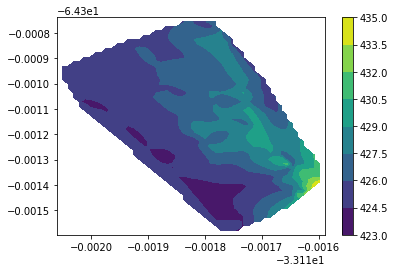

In [12]:
%matplotlib inline

# Mapa de elevación 2D
plt.contourf(xm, ym, zm)
plt.colorbar()

plt.show()

Se realiza un gráfico en tres dimensiones con un método de `triangulación`:

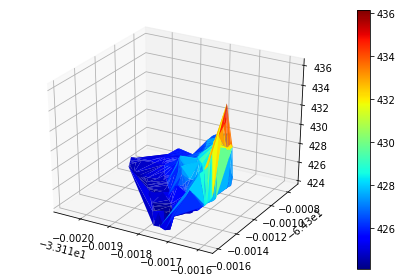

In [13]:
%matplotlib qt

# Triangulación
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

surf = ax.plot_trisurf(x, y, z, cmap=cm.jet, linewidth=0)
fig.colorbar(surf)


fig.tight_layout()

plt.show()

Se emplea el método `plot_surface` de matplotlib para crear una **superficie** mediante mejores algoritmos de extrapolación y su mapa de elevación en tres dimensiones:

/home/bibiana/.conda/envs/mapa-elevacion/lib/python3.6/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


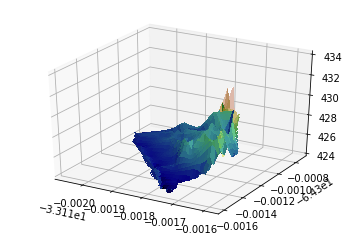

In [14]:
fig, ax = plt.subplots(subplot_kw=dict(projection='3d'))

ls = LightSource(100, 45)
# To use a custom hillshading mode, override the built-in shading and pass
# in the rgb colors of the shaded surface calculated from "shade".
rgb = ls.shade(zm, cmap=cm.gist_earth, vert_exag=0.1, blend_mode='soft')
surf = ax.plot_surface(xm, ym, zm, rstride=1, cstride=1, facecolors=rgb,
                       linewidth=0, antialiased=False, shade=False)

plt.show()

##### Diseño sistema de adquisición de datos

![](img/diagrama_flujo_tiva.png)

#### Procesamiento de los datos

##### Trama NMEA - GPGGA

*National Marine Electronics Association*

* AAM - Waypoint Arrival Alarm.
* ALM - Almanac data.
* GGA - Fix information.
* GLL - Lat/Lon data.
* GSV - Detailed Satellite data.
* RMB - Recommended navigation data for gps.
* RMC - Recommended minimum data for gps.
* TRF - Transit Fix Data.
* ZDA - Date and Time.
+ otras 20 sentencias

Se reciben los datos del receptor GPS en tramas NMEA vía comunicación serial. Se extraen los datos de **latitud, longitud y altitud** de la trama **GPGGA**.

De la [documentación](http://aprs.gids.nl/nmea/#gga), dicha trama es como sigue:

`$--GGA,hhmmss.ss,llll.ll,a,yyyyy.yy,a,x,xx,x.x,x.x,M,x.x,M,x.x,xxxx`

| Parámetro | Descripción |
| --------- | ----------- |
| hhmmss.ss | UTC de la posición. |
| **llll.ll** | **Latitud de la posición** .|
| a | N (Norte) o S (Sur). |
| **yyyyy.yy** | **Longitud de la posicion.** |
| a | E (Este) o W (Oeste). | 
| x | GPS Quality indicator (0=no fix, 1=GPS fix, 2=Dif. GPS fix).| 
| xx | Numero de satelites en uso. | 
| x.x | horizontal dilution of precisión. | 
| x.x | Altitud de la Antena respecto al nivel del mar.|
| **M** | **nidades de la altitud de la Antena, metros.** |
| x.x | Separacion Geoidal.|
| M | Unidades de la separacion geoidal, metros. |
| x.x | Age of Differential GPS data (seconds).| 
| xxxx | Differential reference station ID .|

##### Diseño procesamiento y visualización

![](img/diagrama_flujo_python_1.png)


![](img/diagrama_flujo_python_2.png)

#### Respaldo del módulo de adquisición de datos

Se prevee un sistema de respaldo del módulo de adquisición de datos, conformado por un sistema receptor con conexión USB y comunicación serial a emplear ante indisponibilidad del módulo con Tiva.

![](img/gps_BR-355S4.png)

*Respaldo Tiva*

![](img/diagrama_flujo_gps.png)

### Aplicaciones

* Cartografia.
* Catastrales.
* Agrimensura
* Geológicos.
* Planificacion urbana.
* Topografia.
* Navegacion

#### Aplicaciones Civiles

![](img/civil.jpg)

* Aeródromos en zonas Rurales que no cuentan con una obra civil, y necesitan transporte aéreo en caso de emergencias médicas, 
* Ayuda humanitaria.
* Emergencias Ambientales, bosques, que al igual que el caso anterior  no cuenten con un aeródromo con obra civil.


#### Aplicaciones Militares

![](img/militar.jpg)

* Misiones militares, donde no hay disposición de una pista de aterrizaje aliada, o dicha misión se encuentra demasiado alejada de  una aeródromo o semejante, y la necesidad de apoyo aéreo para transporte de unidades o civiles es de suma importancia


#### Aplicación en Río Cuarto

##### Agrimensura

In [15]:
import io
import base64
from IPython.display import HTML

In [16]:
video = io.open('video/video1.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

In [17]:
video = io.open('video/video2.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

In [18]:
video = io.open('video/video3.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

#### Nuestra contribución

Relevamiento de calles, rutas, para el correcto dimensionamiento de los desagües pluviales.

Se relevan datos de altitud de la trayectoria comprendida entre los puntos determinados por las esquinas *Cabrera y La Rioja* y *La Rioja e Hipólito Yrigoyen* del centro de nuestra ciudad.

![](img/mapa_recorrido_centro.png)

*Puntos relevados en zona de inundaciones en Río Cuarto*

Se confeccionan las curvas de nivel:

![](img/curvas_nivel_centro.png)

*Curvas de nivel en 2D del recorrido*

Y los mapas de elevación en tres dimensiones:

![](img/elevacion_3d_triang.png)

*Mapa en 3D con método de triangulación del recorrido*

![](img/elevacion_3d.png)

*Mapa en 3D con método de triangulación del recorrido*

### Conclusión

El sistema de ayuda a la navegación elegido **GNSS**, más específicamente el sistema **GPS**, sus fundamentos e implementación puede aplicarse a una actividad de interés en el campo de la Ingeniería Civíl, más precisamente en la confección de curvas de nivel y mapas de elevación de un terreno, contribuyendo así con la adquisición de datos, su procesamiento y automatización, resultando en una visualización amigable y atractiva para su análisis y toma de desiciones, con hardware de bajo costo y pocas lineas de código.

### Proyección

Una evolución interesante del sub sistema de adquisición de datos, se proyecta añadiendo un **drone** para el recorrido autónomo del terreno.

![](img/drone.jpg)

### ANEXO

Registros del relevamiento de datos:

![](img/foto_0.jpg)

![](img/foto.jpg)

![](img/foto_2.jpg)

![](img/foto_3.jpg)

![](img/foto_4.jpg)

![](img/foto_5.jpg)

![](img/foto_6.jpg)

![](img/foto_7.jpg)

![](img/foto_8.jpg)

![](img/foto_9.jpg)

![](img/conclusion.png)